# Volcano plot
- mode: HILICpos

In [77]:
# Let the middle rows included.
options(repr.matrix.max.rows=600, repr.matrix.max.cols=200)
# options(warn=-1)

In [78]:
# Load packages
library(dplyr)
library(ggplot2)

# Install ggrepel package if needed
# install.packages("devtools")
# devtools::install_github("slowkow/ggrepel")
library(ggrepel) #To be able to make ggplot without overlapping labeling
library(glue)

In [79]:
# Read data from the web
res_file_name = "../../output/hMinImp_TICnorm_groupFil0.3_RPneg_1wayANOVA/one_wayANOVA_hMinImp_TICnorm_groupFil0.3_RPneg_fullreport.csv"
annot_file_name = "../../../asari-output-RPneg/output_asari_project_31312361/Feature_annotation.tsv"
res_df = read.table(res_file_name, row.names = 1,header=TRUE, sep = ',')

In [80]:
head(res_df)

,gMean_Tn,gMean_CD8stem,gMean_CD8trans,gMean_CD8TD,log2FC_CD8stemvsTn,log2FC_CD8transvsTn,log2FC_CD8TDvsTn,log2FC_CD8transvsCD8stem,log2FC_CD8TDvsCD8stem,log2FC_CD8TDvsCD8trans,f_score,pval,padj,Tpadj_CD8TD.CD8stem,Tpadj_CD8trans.CD8stem,Tpadj_Tn.CD8stem,Tpadj_CD8trans.CD8TD,Tpadj_Tn.CD8TD,Tpadj_Tn.CD8trans,TFDR_CD8TD.CD8stem,TFDR_CD8trans.CD8stem,TFDR_Tn.CD8stem,TFDR_CD8trans.CD8TD,TFDR_Tn.CD8TD,TFDR_Tn.CD8trans,CD8TD_750K_1,CD8TD_750K_2,CD8stem_250K_1,CD8stem_300K_2,CD8trans_250K_2,CD8trans_350K_1,Tn_250K_1,Tn_250K_2,pooled_1,pooled_2,pooled_3
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
F10,16.76541,16.25004,16.26637,15.68275,-0.51537320,-0.49904122,-1.0826623,0.01633199,-0.5672891,-0.5836211,1.1183943,0.440576820,0.60259382,0.77876083,0.9999911,0.82021992,0.765302913,0.3788432,0.832740383,1.0000000,1,1,1.0000000,0.7513561,1.0000000,15.68275,15.68275,16.81733,15.68275,16.84999,15.68275,16.57091,16.95991,17.81606,15.68275,16.73556
F100,19.60717,20.60583,20.49945,19.60717,0.99865942,0.89228382,0.0000000,-0.10637560,-0.9986594,-0.8922838,1.4514513,0.353472418,0.54403432,0.48919424,0.9981212,0.48919424,0.565276958,1.0000000,0.565276958,0.8998162,1,1,1.0000000,1.0000000,1.0000000,19.60717,19.60717,20.43205,20.77960,19.60717,21.39174,19.60717,19.60717,19.60717,21.20800,21.41404
F1000,17.50587,18.81196,20.05414,17.50587,1.30608565,2.54826493,0.0000000,1.24217928,-1.3060856,-2.5482649,23.1302407,0.005467544,0.07108504,0.07144657,0.0831093,0.07144657,0.007219173,1.0000000,0.007219173,0.3602651,1,1,0.1547530,1.0000000,0.4456237,17.50587,17.50587,18.33076,19.29316,20.21849,19.88979,17.50587,17.50587,17.50587,17.50587,19.32928
F10000,22.70811,22.53112,22.60602,22.22637,-0.17698304,-0.10208663,-0.4817385,0.07489641,-0.3047554,-0.3796519,2.8855602,0.166199949,0.36106174,0.40286975,0.9694547,0.74632597,0.265841188,0.1511776,0.929753453,0.8133870,1,1,0.7473376,0.4325591,1.0000000,22.44564,22.00710,22.55649,22.50576,22.67540,22.53664,22.62988,22.78634,22.36898,22.41527,22.36277
F10001,19.82699,19.78943,19.77887,19.48771,-0.03756018,-0.04812267,-0.3392773,-0.01056249,-0.3017171,-0.2911546,0.2131211,0.882674849,0.90698949,0.91776802,0.9999955,0.99979874,0.924941502,0.8897570,0.999577808,1.0000000,1,1,1.0000000,1.0000000,1.0000000,20.12789,18.84753,19.88193,19.69693,19.94176,19.61597,19.70016,19.95381,19.51083,19.60266,19.63396
F10002,23.29157,23.18800,23.17135,22.43197,-0.10356792,-0.12022386,-0.8595981,-0.01665595,-0.7560302,-0.7393742,3.1141044,0.150600078,0.34284492,0.22266385,0.9999391,0.98631220,0.234213933,0.1631453,0.979080530,0.6032178,1,1,0.6982227,0.4522273,1.0000000,22.45921,22.40474,23.12342,23.25258,23.40112,22.94157,22.91235,23.67079,22.78907,22.86479,22.86133


-------

-------

-------

## Create output directory

In [81]:
out_dir = "../../output/hMinImp_TICnorm_groupFil0.3_RPneg_1wayANOVA/volcano_plot/"
dir.create(out_dir)

Warning message in dir.create(out_dir):
“'../../output/hMinImp_TICnorm_groupFil0.3_RPneg_1wayANOVA/volcano_plot' already exists”


In [82]:
head(res_df,2)

,gMean_Tn,gMean_CD8stem,gMean_CD8trans,gMean_CD8TD,log2FC_CD8stemvsTn,log2FC_CD8transvsTn,log2FC_CD8TDvsTn,log2FC_CD8transvsCD8stem,log2FC_CD8TDvsCD8stem,log2FC_CD8TDvsCD8trans,f_score,pval,padj,Tpadj_CD8TD.CD8stem,Tpadj_CD8trans.CD8stem,Tpadj_Tn.CD8stem,Tpadj_CD8trans.CD8TD,Tpadj_Tn.CD8TD,Tpadj_Tn.CD8trans,TFDR_CD8TD.CD8stem,TFDR_CD8trans.CD8stem,TFDR_Tn.CD8stem,TFDR_CD8trans.CD8TD,TFDR_Tn.CD8TD,TFDR_Tn.CD8trans,CD8TD_750K_1,CD8TD_750K_2,CD8stem_250K_1,CD8stem_300K_2,CD8trans_250K_2,CD8trans_350K_1,Tn_250K_1,Tn_250K_2,pooled_1,pooled_2,pooled_3
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
F10,16.76541,16.25004,16.26637,15.68275,-0.5153732,-0.4990412,-1.082662,0.01633199,-0.5672891,-0.5836211,1.118394,0.4405768,0.6025938,0.7787608,0.9999911,0.8202199,0.7653029,0.3788432,0.8327404,1.0000000,1,1,1,0.7513561,1,15.68275,15.68275,16.81733,15.68275,16.84999,15.68275,16.57091,16.95991,17.81606,15.68275,16.73556
F100,19.60717,20.60583,20.49945,19.60717,0.9986594,0.8922838,0.000000,-0.10637560,-0.9986594,-0.8922838,1.451451,0.3534724,0.5440343,0.4891942,0.9981212,0.4891942,0.5652770,1.0000000,0.5652770,0.8998162,1,1,1,1.0000000,1,19.60717,19.60717,20.43205,20.77960,19.60717,21.39174,19.60717,19.60717,19.60717,21.20800,21.41404


------

------

------

# Volcano plot function

In [83]:
volcano_plot <- function(res_df = res_df,
                            padj_colname = padj_colname,
                            log2FC_colname = log2FC_colname,
                            p_cut_off = p_cut_off,
                            log2FC_cut_off = log2FC_cut_off,
                            xlab = xlab,
                            ylab = '-log10(adj. p-val)',
                            xlim = xlim,
                            ylim = ylim,
                            highlight_text = FALSE,
                            fig_width = 8,
                            fig_height = 8,
                            text_size = 20,
                            legend_size = 20,
                            axis_title_size = 20,
                            output_dir = "",
                            pdf_prefix = 'test',
                            show_plot = TRUE) {
    
    colnames(res_df)
    res_df = mutate(res_df, 
                     Label = ifelse((res_df[,padj_colname] < p_cut_off) & (abs(res_df[,log2FC_colname]) > 1),  # Label is the column that distinguish the coloring
                                  "Significant", 
                                  "Not Sign.")) #mutate is a good function 

    res_df$log10padj = -log(res_df[,padj_colname],10)
    print(paste0("range of log10padj: ", range(res_df$log10padj),'\n', "range of log2FC: ", range(res_df$log2FC)))
    
    options(repr.plot.width = fig_width, repr.plot.height = fig_height)
    
    hist(res_df[,log2FC_colname], breaks =30)
    
    p = ggplot( res_df, 
                aes_string(log2FC_colname,"log10padj")) +
                geom_point(aes(col=Label), alpha = 0.5) +
                scale_color_manual(values=c("#888888","#ff0000")) +
                xlim(xlim) + 
                ylim(ylim) + 
                xlab(xlab) +
                ylab(ylab) +
                
                theme(
                      panel.grid.major = element_line(colour = "grey50",linetype = "dashed", size = 0.2),
                      panel.border = element_rect(fill = NA),
                      #panel.grid.minor = element_blank(),
                      panel.background = element_rect(fill = "transparent",colour = NA),
                      plot.background = element_rect(fill = "transparent",colour = NA),
                      axis.text = element_text(size = text_size, colour="black"),
                      axis.text.x = element_text(colour="black"),
                      legend.text= element_text(size = legend_size),
                      legend.title = element_text(size = legend_size),
                      axis.title = element_text(size = axis_title_size)
                    )
    if(highlight_text == TRUE) {
        print("With highlighted text")
        p = p + geom_text_repel(data = filter(res_df, highlight != ""), 
                                aes(label = highlight),
                                max.overlaps = Inf)
    }
    
    if (show_plot == TRUE) {
        print(p) # display the plot
    } else {return(p)}

    if (length(output_dir)!=0) {
            ggsave(file.path(output_dir, 
                             glue("volcano_plot_",
                                                pdf_prefix,".pdf")), 
                   width = fig_width, 
                   height = fig_height)
        }
}

select_topN2present <- function(res_df, annot_df, topN, padj_label) {
    res_df = res_df %>% arrange_(padj_colname) 
    featIDs = rownames(res_df[1:topN,])
    annot_list = list()
    res_df['highlight'] = ""
    for (featID in featIDs) {
        res_df[featID,'highlight'] = annot_df[annot_df['X.peak.id_number']==featID,'name_1st_guess'][1]
    }
    
    return(res_df)
}

------

# Volcano plot
## log2FC CD8TD vs. CD8stem

In [84]:
colnames(res_df)

[1] "gMean_Tn"                 "gMean_CD8stem"           
 [3] "gMean_CD8trans"           "gMean_CD8TD"             
 [5] "log2FC_CD8stemvsTn"       "log2FC_CD8transvsTn"     
 [7] "log2FC_CD8TDvsTn"         "log2FC_CD8transvsCD8stem"
 [9] "log2FC_CD8TDvsCD8stem"    "log2FC_CD8TDvsCD8trans"  
[11] "f_score"                  "pval"                    
[13] "padj"                     "Tpadj_CD8TD.CD8stem"     
[15] "Tpadj_CD8trans.CD8stem"   "Tpadj_Tn.CD8stem"        
[17] "Tpadj_CD8trans.CD8TD"     "Tpadj_Tn.CD8TD"          
[19] "Tpadj_Tn.CD8trans"        "TFDR_CD8TD.CD8stem"      
[21] "TFDR_CD8trans.CD8stem"    "TFDR_Tn.CD8stem"         
[23] "TFDR_CD8trans.CD8TD"      "TFDR_Tn.CD8TD"           
[25] "TFDR_Tn.CD8trans"         "CD8TD_750K_1"            
[27] "CD8TD_750K_2"             "CD8stem_250K_1"          
[29] "CD8stem_300K_2"           "CD8trans_250K_2"         
[31] "CD8trans_350K_1"          "Tn_250K_1"               
[33] "Tn_250K_2"                "pooled_1"                
[35] "pooled_2"                 "pooled_3"

In [85]:
padj_colname = 'Tpadj_CD8TD.CD8stem'
log2FC_colname = 'log2FC_CD8TDvsCD8stem'
contrast = "CD8TD vs. CD8stem"

### No highlight

Warning message in min(x, na.rm = na.rm):
“no non-missing arguments to min; returning Inf”
Warning message in max(x, na.rm = na.rm):
“no non-missing arguments to max; returning -Inf”


[1] "range of log10padj: 0\nrange of log2FC: Inf"                
[2] "range of log10padj: 13.0282473235653\nrange of log2FC: -Inf"


Warning message:
“Removed 7 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 7 rows containing missing values (`geom_point()`).”


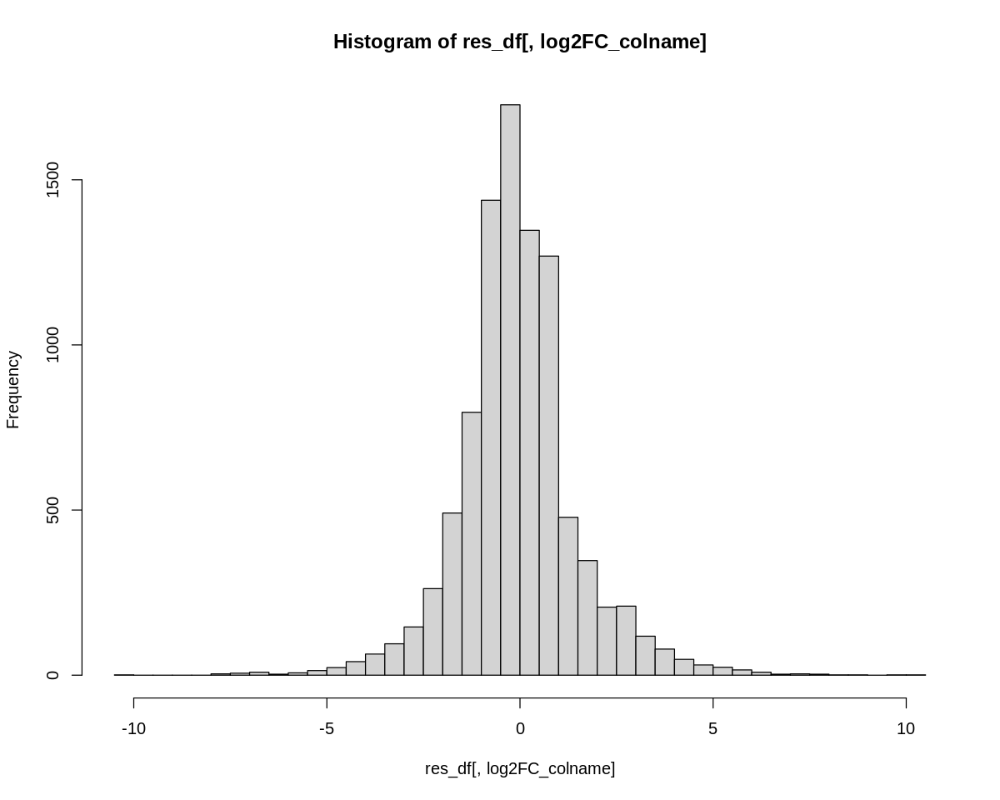

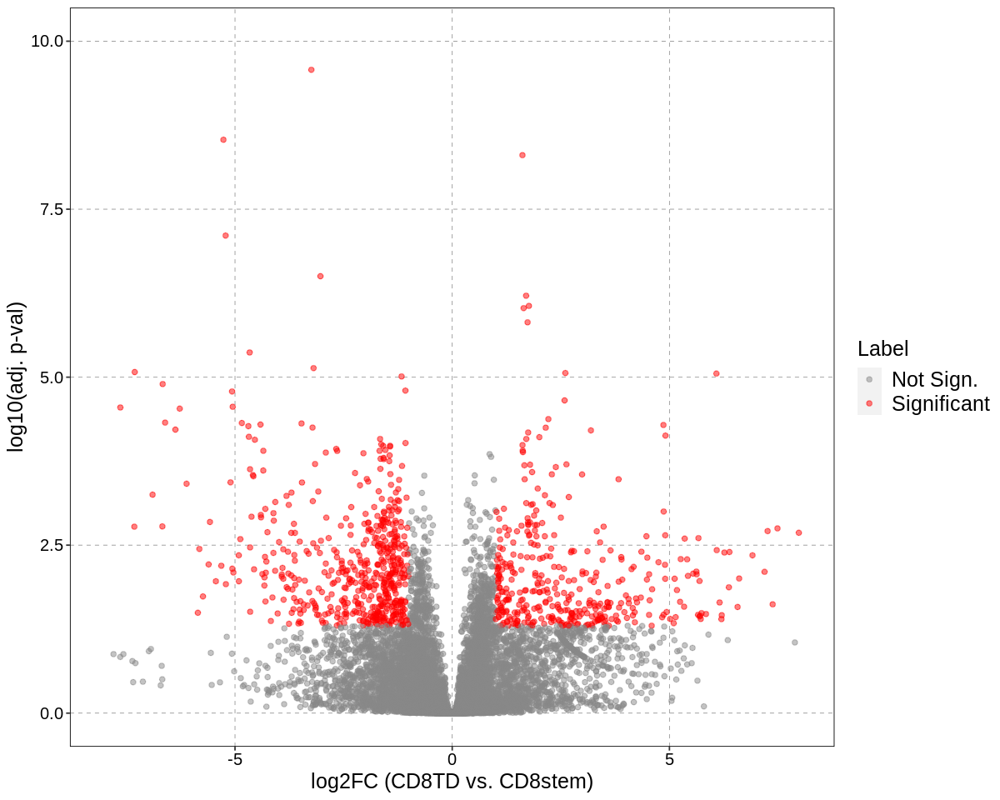

In [86]:
volcano_plot(res_df = res_df,
                padj_colname = padj_colname,
                log2FC_colname = log2FC_colname,
                p_cut_off = 0.05,
                log2FC_cut_off = 1,
                xlab = glue("log2FC ({contrast})"),
                ylab = 'log10(adj. p-val)',
                xlim = c(-8,8),
                ylim = c(0,10),
                highlight = FALSE,
                fig_width = 10,
                fig_height = 8,
                text_size = 12,
                legend_size = 15,
                axis_title_size = 15,
                output_dir = out_dir,
                pdf_prefix = glue('{contrast}'),
                show_plot = TRUE)

## With highlight

### Select parameters for highlight

In [87]:
if(want2annotate_feature_name) {
    annot_df = read.csv(annot_file_name, sep = '\t') #somehow only dplyr read.csv works 
    res_df = select_topN2present(res_df, annot_df, topN)
}

Warning message:
“`arrange_()` was deprecated in dplyr 0.7.0.
ℹ Please use `arrange()` instead.
ℹ See vignette('programming') for more help”


In [88]:
want2annotate_feature_name = TRUE
topN = 200

In [89]:
unique(res_df$highlight)

[1] "Germanicol cinnamate"                     
 [2] "PE(16:0/P-18:1(11Z))"                     
 [3] ""                                         
 [4] "Cer(d18:1/18:0)"                          
 [5] "PA(18:1(11Z)/22:2(13Z,16Z))"              
 [6] "PS(18:1(11Z)/24:1(15Z))"                  
 [7] "PI(16:0/22:4(10Z,13Z,16Z,19Z))"           
 [8] "Austalide J"                              
 [9] "Cerebroside B"                            
[10] "SM(d18:1/16:0)"                           
[11] "PC(15:0/16:1(9Z))"                        
[12] "PI(16:0/18:1(11Z))"                       
[13] "PE(18:1(11Z)/22:6(4Z,7Z,10Z,13Z,16Z,19Z))"
[14] "PE(P-18:0/20:4(5Z,8Z,11Z,14Z))"           
[15] "LysoPA(0:0/16:0)"                         
[16] "PE(22:4(7Z,10Z,13Z,16Z)/P-18:0)"          
[17] "Epomusenin A"

Warning message in min(x, na.rm = na.rm):
“no non-missing arguments to min; returning Inf”
Warning message in max(x, na.rm = na.rm):
“no non-missing arguments to max; returning -Inf”


[1] "range of log10padj: 0\nrange of log2FC: Inf"                
[2] "range of log10padj: 13.0282473235653\nrange of log2FC: -Inf"
[1] "With highlighted text"


Warning message:
“Removed 7 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 2 rows containing missing values (`geom_text_repel()`).”
Warning message:
“Removed 7 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 2 rows containing missing values (`geom_text_repel()`).”


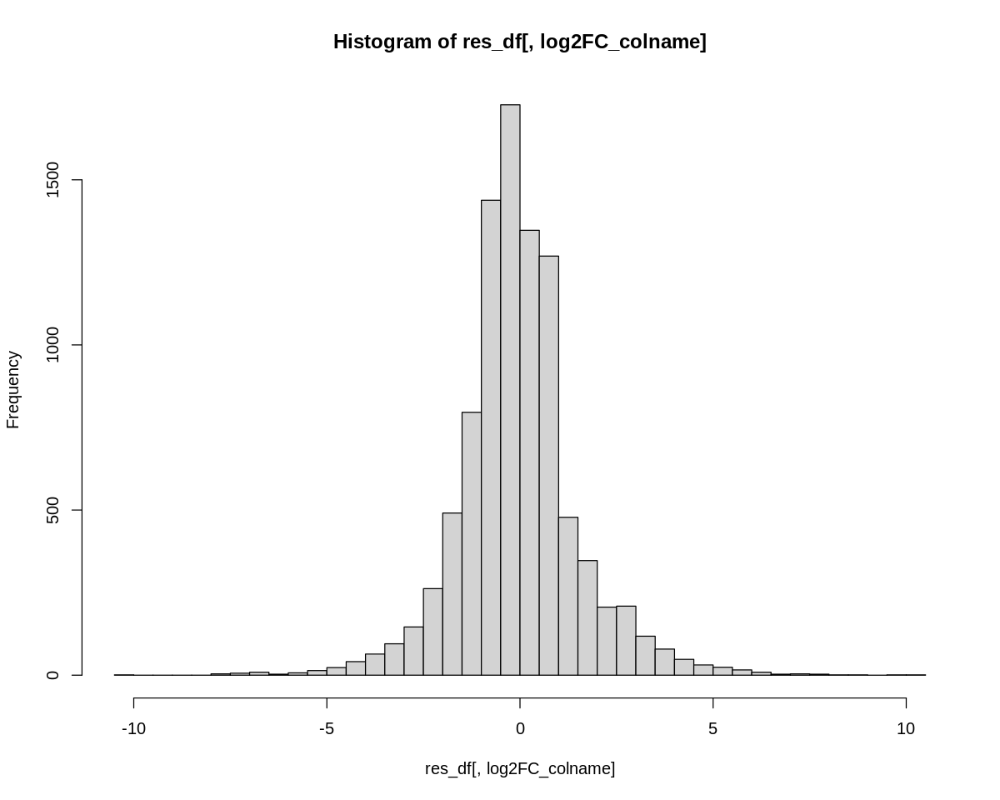

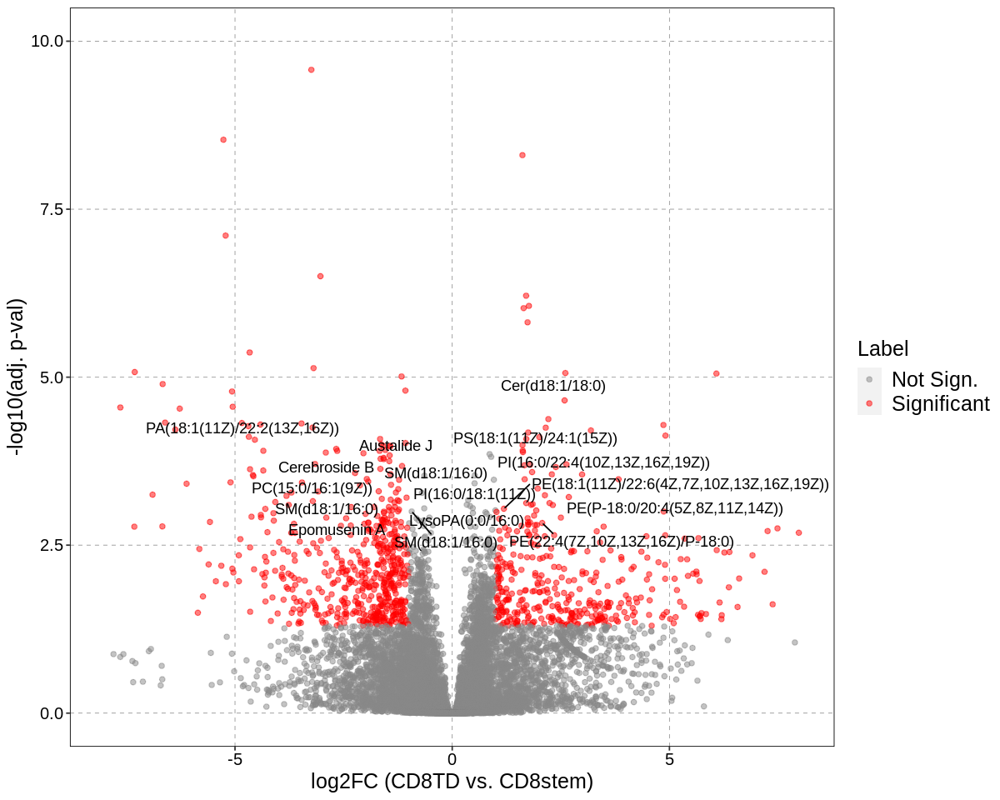

In [90]:
volcano_plot(   res_df = res_df,
                padj_colname = padj_colname,
                log2FC_colname = log2FC_colname,
                p_cut_off = 0.05,
                log2FC_cut_off = 1,
                xlab = glue("log2FC ({contrast})"),
                ylab = '-log10(adj. p-val)',
                xlim = c(-8,8),
                ylim = c(0,10),
                highlight_text = TRUE,
                fig_width = 10,
                fig_height = 8,
                text_size = 12,
                legend_size = 15,
                axis_title_size = 15,
                output_dir = out_dir,
                pdf_prefix = glue('{contrast}_with_highlight{topN}'),
                show_plot = TRUE)

--------

------

# Volcano plot
## log2FC CD8TD vs. Tn

In [91]:
colnames(res_df)[grep("Tpadj",colnames(res_df))]

[1] "Tpadj_CD8TD.CD8stem"    "Tpadj_CD8trans.CD8stem" "Tpadj_Tn.CD8stem"      
[4] "Tpadj_CD8trans.CD8TD"   "Tpadj_Tn.CD8TD"         "Tpadj_Tn.CD8trans"

In [92]:
colnames(res_df)[grep("log2FC",colnames(res_df))]

[1] "log2FC_CD8stemvsTn"       "log2FC_CD8transvsTn"     
[3] "log2FC_CD8TDvsTn"         "log2FC_CD8transvsCD8stem"
[5] "log2FC_CD8TDvsCD8stem"    "log2FC_CD8TDvsCD8trans"

In [93]:
padj_colname = 'Tpadj_Tn.CD8TD'
log2FC_colname = 'log2FC_CD8TDvsTn'
contrast = "CD8TD vs. Tn"

### No highlight

Warning message in min(x, na.rm = na.rm):
“no non-missing arguments to min; returning Inf”
Warning message in max(x, na.rm = na.rm):
“no non-missing arguments to max; returning -Inf”


[1] "range of log10padj: 0\nrange of log2FC: Inf"                
[2] "range of log10padj: 13.0282473235653\nrange of log2FC: -Inf"


Warning message:
“Removed 19 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 19 rows containing missing values (`geom_point()`).”


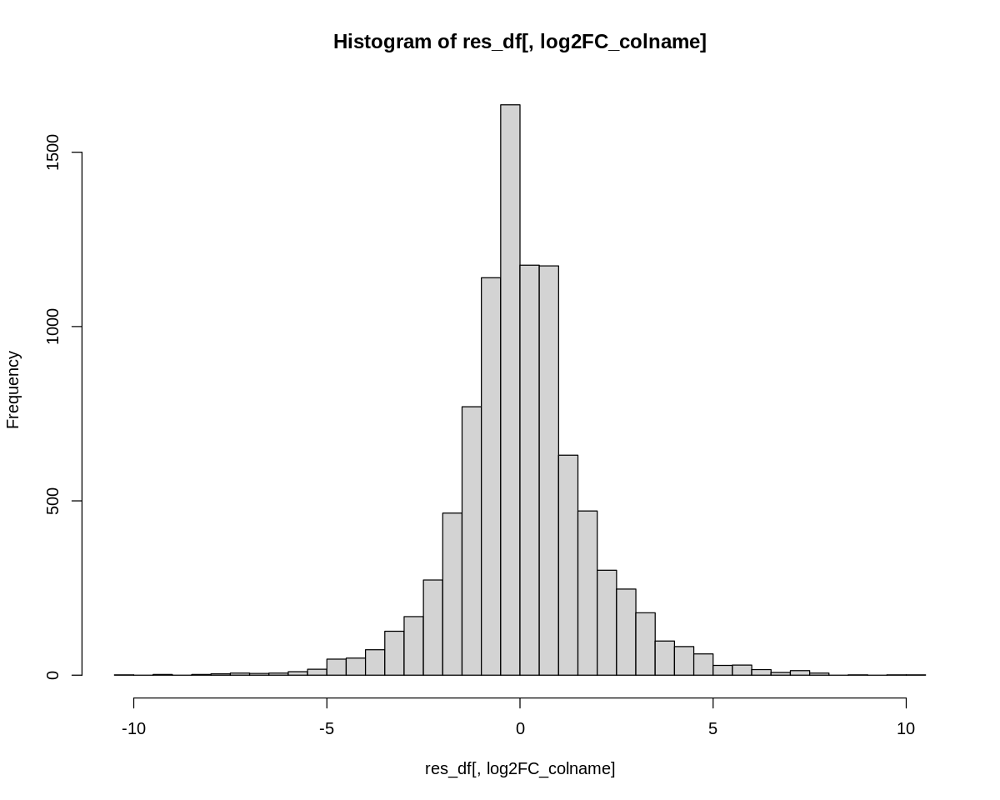

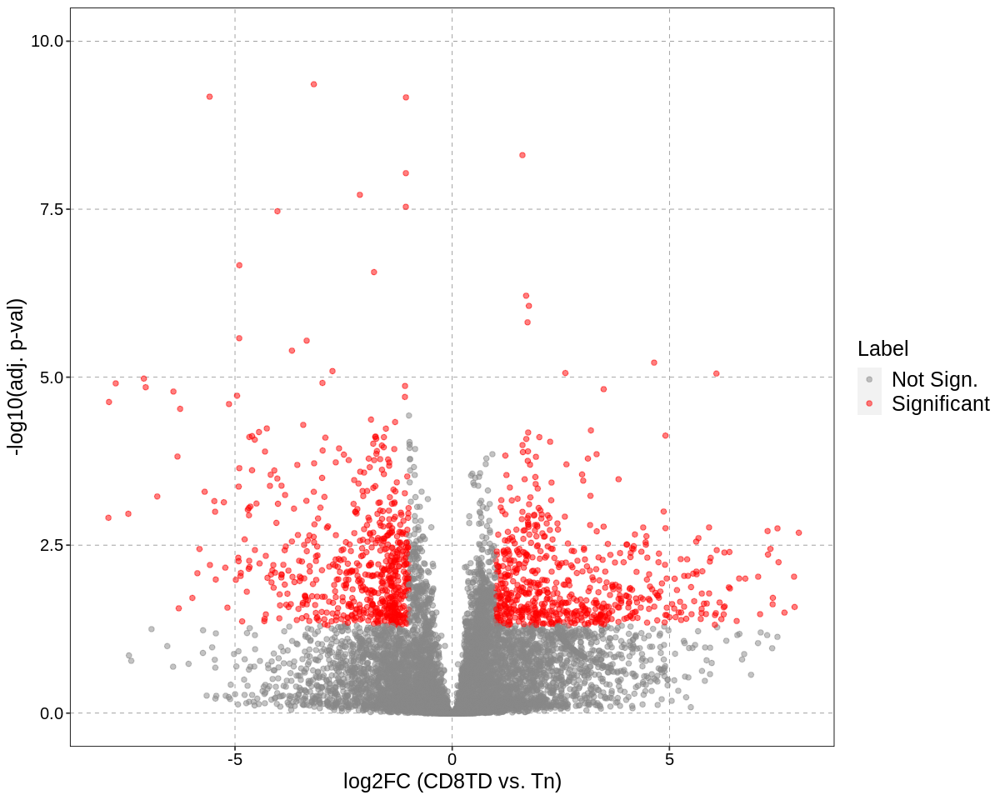

In [94]:
volcano_plot(res_df = res_df,
                padj_colname = padj_colname,
                log2FC_colname = log2FC_colname,
                p_cut_off = 0.05,
                log2FC_cut_off = 1,
                xlab = glue("log2FC ({contrast})"),
                ylab = '-log10(adj. p-val)',
                xlim = c(-8,8),
                ylim = c(0,10),
                highlight = FALSE,
                fig_width = 10,
                fig_height = 8,
                text_size = 12,
                legend_size = 15,
                axis_title_size = 15,
                output_dir = out_dir,
                pdf_prefix = glue('{contrast}'),
                show_plot = TRUE)

## With highlight

### Select parameters for highlight

In [95]:
if(want2annotate_feature_name) {
    annot_df = read.csv(annot_file_name, sep = '\t') #somehow only dplyr read.csv works 
    res_df = select_topN2present(res_df, annot_df, topN)
}

Warning message:
“`arrange_()` was deprecated in dplyr 0.7.0.
ℹ Please use `arrange()` instead.
ℹ See vignette('programming') for more help”


In [96]:
want2annotate_feature_name = TRUE
topN = 200

In [97]:
unique(res_df$highlight)

[1] "Germanicol cinnamate"                                                                            
 [2] "PE(16:0/P-18:1(11Z))"                                                                            
 [3] ""                                                                                                
 [4] "6-{[3-(1,2-dihydroxybutyl)-1-oxo-1H-isochromen-7-yl]oxy}-3,4,5-trihydroxyoxane-2-carboxylic acid"
 [5] "PI(16:0/18:1(11Z))"                                                                              
 [6] "Cer(d18:1/18:0)"                                                                                 
 [7] "(3b,16a,20R)-25-Acetoxy-3,16,20,22-tetrahydroxy-5-cucurbiten-11-one 3-glucoside"                 
 [8] "PA(18:1(11Z)/22:2(13Z,16Z))"                                                                     
 [9] "Garciduol C"                                                                                     
[10] "Cerebroside B"                                                                                   
[11] "PI(16:0/22:4(10Z,13Z,16Z,19Z))"                                                                  
[12] "PE(18:1(11Z)/22:6(4Z,7Z,10Z,13Z,16Z,19Z))"                                                       
[13] "Austalide J"                                                                                     
[14] "SM(d18:1/16:0)"                                                                                  
[15] "PI(18:0/22:4(10Z,13Z,16Z,19Z))"                                                                  
[16] "PC(15:0/16:1(9Z))"                                                                               
[17] "PC(15:0/18:2(9Z,12Z))"                                                                           
[18] "PC(15:0/22:6(4Z,7Z,10Z,13Z,16Z,19Z))"                                                            
[19] "Epomusenin A"

Warning message in min(x, na.rm = na.rm):
“no non-missing arguments to min; returning Inf”
Warning message in max(x, na.rm = na.rm):
“no non-missing arguments to max; returning -Inf”


[1] "range of log10padj: 0\nrange of log2FC: Inf"                
[2] "range of log10padj: 13.0282473235653\nrange of log2FC: -Inf"
[1] "With highlighted text"


Warning message:
“Removed 19 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 2 rows containing missing values (`geom_text_repel()`).”
Warning message:
“Removed 19 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 2 rows containing missing values (`geom_text_repel()`).”


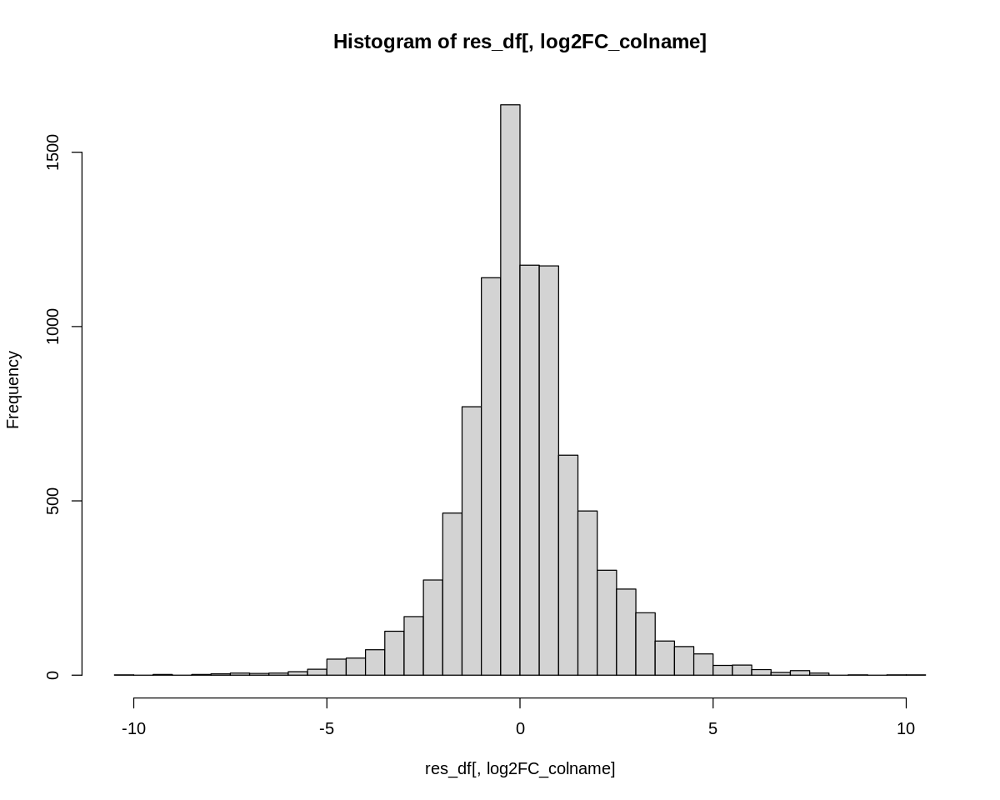

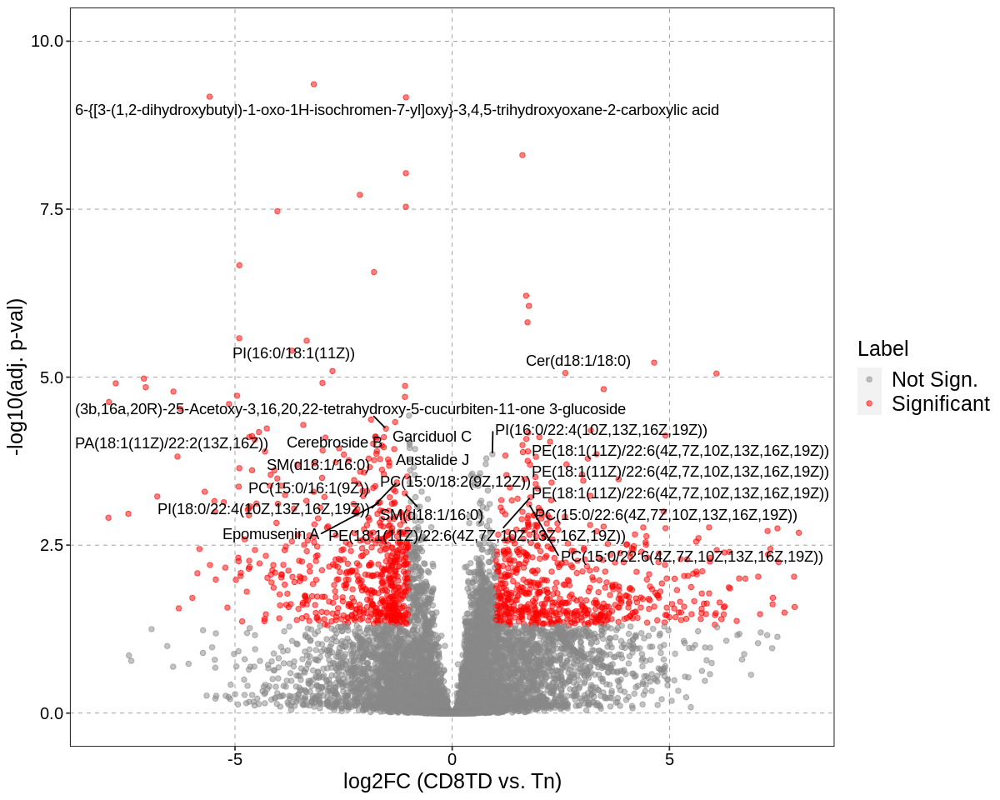

In [98]:
volcano_plot(   res_df = res_df,
                padj_colname = padj_colname,
                log2FC_colname = log2FC_colname,
                p_cut_off = 0.05,
                log2FC_cut_off = 1,
                xlab = glue("log2FC ({contrast})"),
                ylab = '-log10(adj. p-val)',
                xlim = c(-8,8),
                ylim = c(0,10),
                highlight_text = TRUE,
                fig_width = 10,
                fig_height = 8,
                text_size = 12,
                legend_size = 15,
                axis_title_size = 15,
                output_dir = out_dir,
                pdf_prefix = glue('{contrast}_with_highlight{topN}'),
                show_plot = TRUE)

-----

-----

-----

# Volcano plot
## log2FC CD8TD vs. Tn

In [99]:
colnames(res_df)[grep("Tpadj",colnames(res_df))]

[1] "Tpadj_CD8TD.CD8stem"    "Tpadj_CD8trans.CD8stem" "Tpadj_Tn.CD8stem"      
[4] "Tpadj_CD8trans.CD8TD"   "Tpadj_Tn.CD8TD"         "Tpadj_Tn.CD8trans"

In [100]:
colnames(res_df)[grep("log2FC",colnames(res_df))]

[1] "log2FC_CD8stemvsTn"       "log2FC_CD8transvsTn"     
[3] "log2FC_CD8TDvsTn"         "log2FC_CD8transvsCD8stem"
[5] "log2FC_CD8TDvsCD8stem"    "log2FC_CD8TDvsCD8trans"

In [101]:
padj_colname = 'Tpadj_CD8trans.CD8TD'
log2FC_colname = 'log2FC_CD8TDvsCD8trans'
contrast = "CD8TD vs. CD8trans"

### With highlight

### Select parameters for highlight

In [102]:
if(want2annotate_feature_name) {
    annot_df = read.csv(annot_file_name, sep = '\t') #somehow only dplyr read.csv works 
    res_df = select_topN2present(res_df, annot_df, topN)
}

Warning message:
“`arrange_()` was deprecated in dplyr 0.7.0.
ℹ Please use `arrange()` instead.
ℹ See vignette('programming') for more help”


In [103]:
want2annotate_feature_name = TRUE
topN = 200

In [104]:
unique(res_df$highlight)

[1] "Germanicol cinnamate"                                                           
 [2] "PE(16:0/P-18:1(11Z))"                                                           
 [3] ""                                                                               
 [4] "Cer(d18:1/18:0)"                                                                
 [5] "PA(18:1(11Z)/22:2(13Z,16Z))"                                                    
 [6] "PI(16:0/22:4(10Z,13Z,16Z,19Z))"                                                 
 [7] "PS(18:1(11Z)/24:1(15Z))"                                                        
 [8] "(3b,16a,20R)-25-Acetoxy-3,16,20,22-tetrahydroxy-5-cucurbiten-11-one 3-glucoside"
 [9] "Cerebroside B"                                                                  
[10] "Austalide J"                                                                    
[11] "SM(d18:1/16:0)"                                                                 
[12] "Epomusenin A"                                                                   
[13] "PC(15:0/16:1(9Z))"                                                              
[14] "PC(15:0/18:2(9Z,12Z))"                                                          
[15] "DG(14:0/0:0/18:3n6)"                                                            
[16] "Sabadelin"

Warning message in min(x, na.rm = na.rm):
“no non-missing arguments to min; returning Inf”
Warning message in max(x, na.rm = na.rm):
“no non-missing arguments to max; returning -Inf”


[1] "range of log10padj: 0\nrange of log2FC: Inf"                
[2] "range of log10padj: 13.0282473235653\nrange of log2FC: -Inf"
[1] "With highlighted text"


Warning message:
“Removed 7 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 2 rows containing missing values (`geom_text_repel()`).”
Warning message:
“Removed 7 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 2 rows containing missing values (`geom_text_repel()`).”


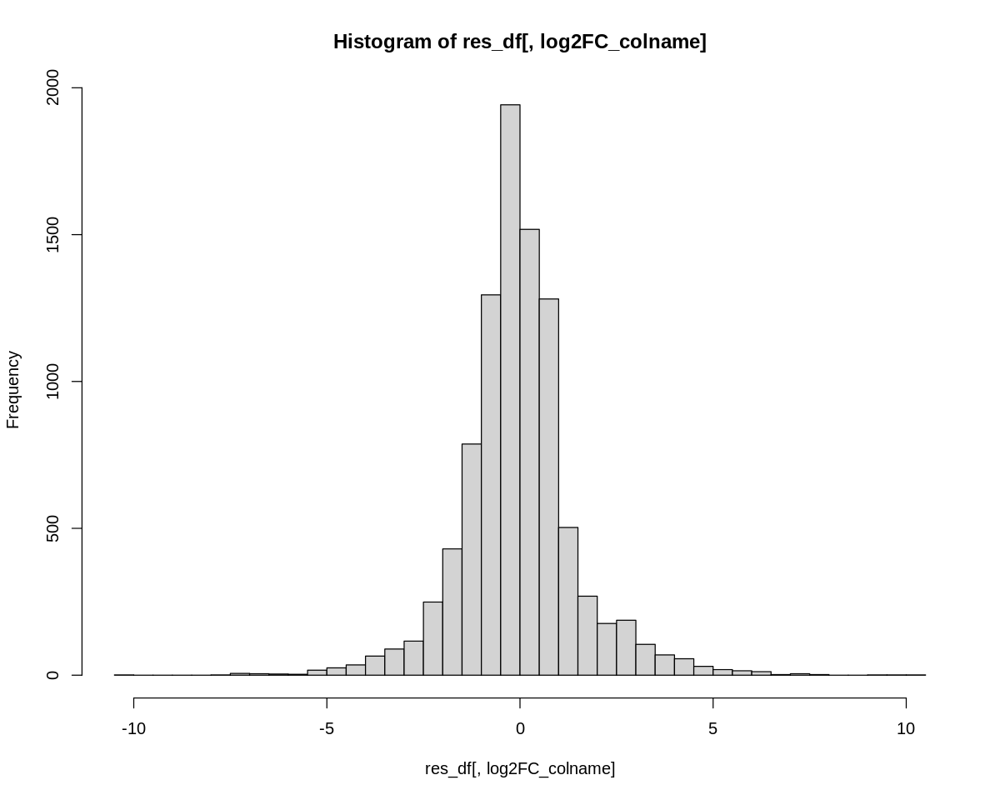

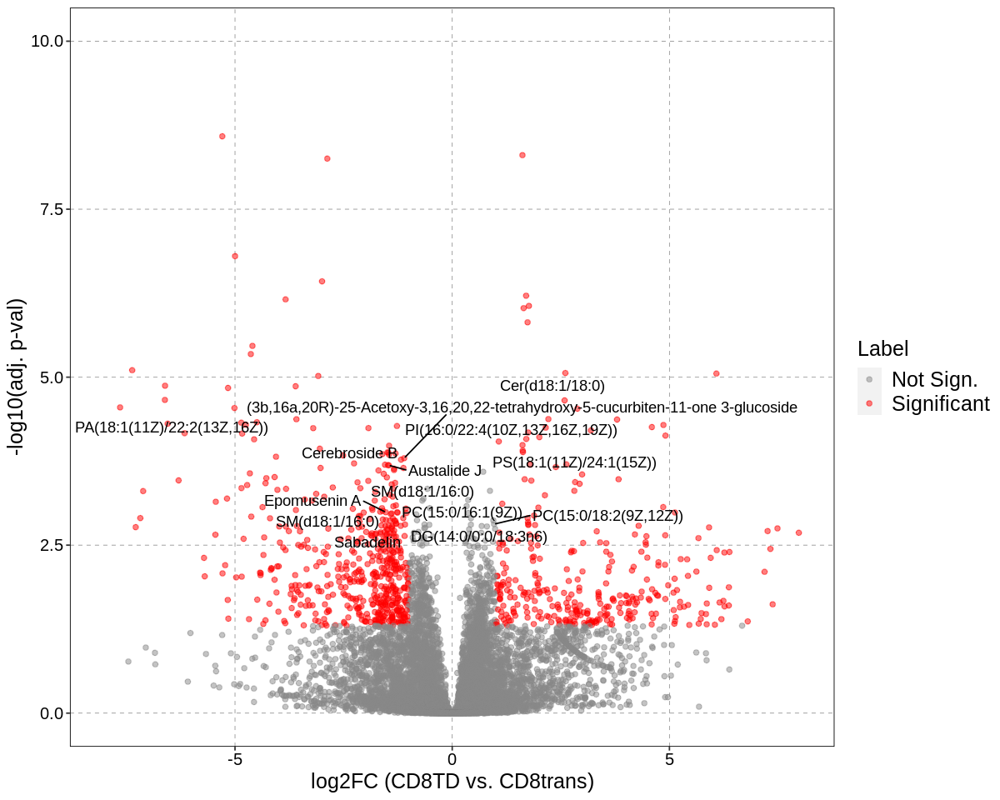

In [105]:
volcano_plot(   res_df = res_df,
                padj_colname = padj_colname,
                log2FC_colname = log2FC_colname,
                p_cut_off = 0.05,
                log2FC_cut_off = 1,
                xlab = glue("log2FC ({contrast})"),
                ylab = '-log10(adj. p-val)',
                xlim = c(-8,8),
                ylim = c(0,10),
                highlight_text = TRUE,
                fig_width = 10,
                fig_height = 8,
                text_size = 12,
                legend_size = 15,
                axis_title_size = 15,
                output_dir = out_dir,
                pdf_prefix = glue('{contrast}_with_highlight{topN}'),
                show_plot = TRUE)

-----

-----

-----

# Volcano plot
## log2FC CD8trans vs. Tn

In [106]:
colnames(res_df)[grep("Tpadj",colnames(res_df))]

[1] "Tpadj_CD8TD.CD8stem"    "Tpadj_CD8trans.CD8stem" "Tpadj_Tn.CD8stem"      
[4] "Tpadj_CD8trans.CD8TD"   "Tpadj_Tn.CD8TD"         "Tpadj_Tn.CD8trans"

In [107]:
colnames(res_df)[grep("log2FC",colnames(res_df))]

[1] "log2FC_CD8stemvsTn"       "log2FC_CD8transvsTn"     
[3] "log2FC_CD8TDvsTn"         "log2FC_CD8transvsCD8stem"
[5] "log2FC_CD8TDvsCD8stem"    "log2FC_CD8TDvsCD8trans"

In [108]:
padj_colname = 'Tpadj_Tn.CD8trans'
log2FC_colname = 'log2FC_CD8transvsTn'
contrast = "CD8trans vs. Tn"

### With highlight

### Select parameters for highlight

In [109]:
if(want2annotate_feature_name) {
    annot_df = read.csv(annot_file_name, sep = '\t') #somehow only dplyr read.csv works 
    res_df = select_topN2present(res_df, annot_df, topN)
}

Warning message:
“`arrange_()` was deprecated in dplyr 0.7.0.
ℹ Please use `arrange()` instead.
ℹ See vignette('programming') for more help”


In [110]:
want2annotate_feature_name = TRUE
topN = 200

In [111]:
unique(res_df$highlight)

[1] ""                                                                                                
 [2] "6-{[3-(1,2-dihydroxybutyl)-1-oxo-1H-isochromen-7-yl]oxy}-3,4,5-trihydroxyoxane-2-carboxylic acid"
 [3] "PI(16:0/18:1(11Z))"                                                                              
 [4] "Garciduol C"                                                                                     
 [5] "PS(18:1(11Z)/24:1(15Z))"                                                                         
 [6] "PE(18:1(11Z)/22:6(4Z,7Z,10Z,13Z,16Z,19Z))"                                                       
 [7] "PI(18:0/22:4(10Z,13Z,16Z,19Z))"                                                                  
 [8] "Eplerenone"                                                                                      
 [9] "Cer(d18:1/16:0)"                                                                                 
[10] "Prostaglandin G2 2-glyceryl Ester"                                                               
[11] "PC(15:0/22:6(4Z,7Z,10Z,13Z,16Z,19Z))"                                                            
[12] "Cinitapride"                                                                                     
[13] "PE(P-18:0/20:4(5Z,8Z,11Z,14Z))"                                                                  
[14] "(3b,16a,20R)-25-Acetoxy-3,16,20,22-tetrahydroxy-5-cucurbiten-11-one 3-glucoside"                 
[15] "Ceanothine B"                                                                                    
[16] "PE(14:0/20:2(11Z,14Z))"

Warning message in min(x, na.rm = na.rm):
“no non-missing arguments to min; returning Inf”
Warning message in max(x, na.rm = na.rm):
“no non-missing arguments to max; returning -Inf”


[1] "range of log10padj: 0\nrange of log2FC: Inf"                
[2] "range of log10padj: 13.0282473235653\nrange of log2FC: -Inf"
[1] "With highlighted text"


Warning message:
“Removed 11 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 11 rows containing missing values (`geom_point()`).”


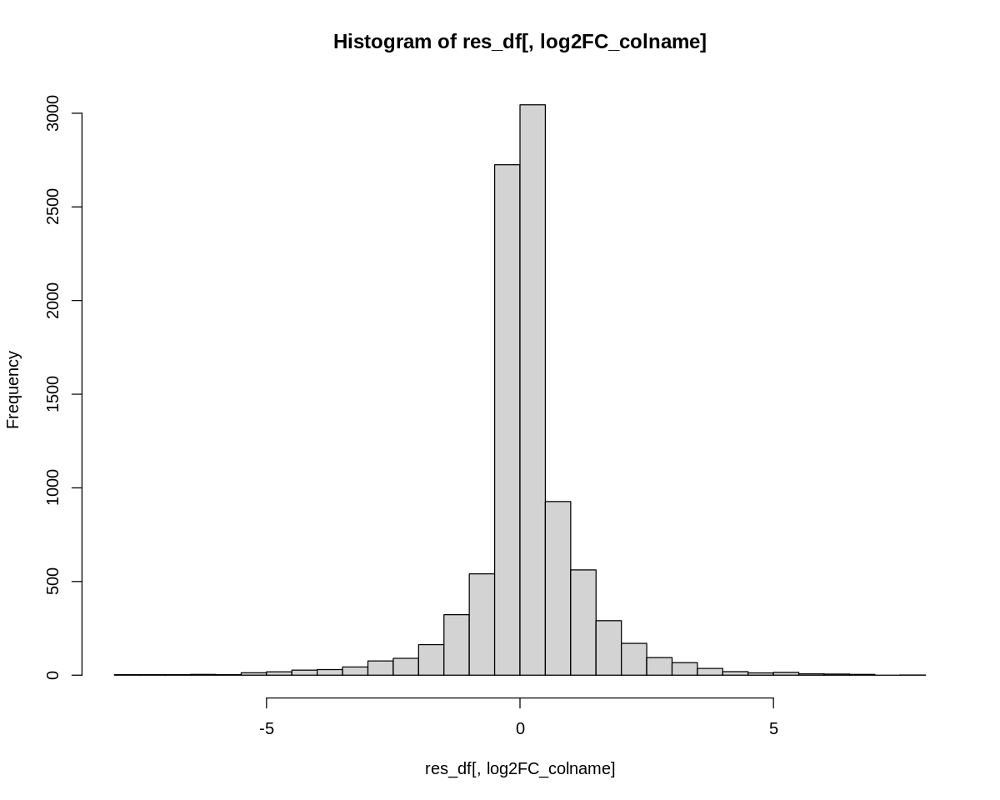

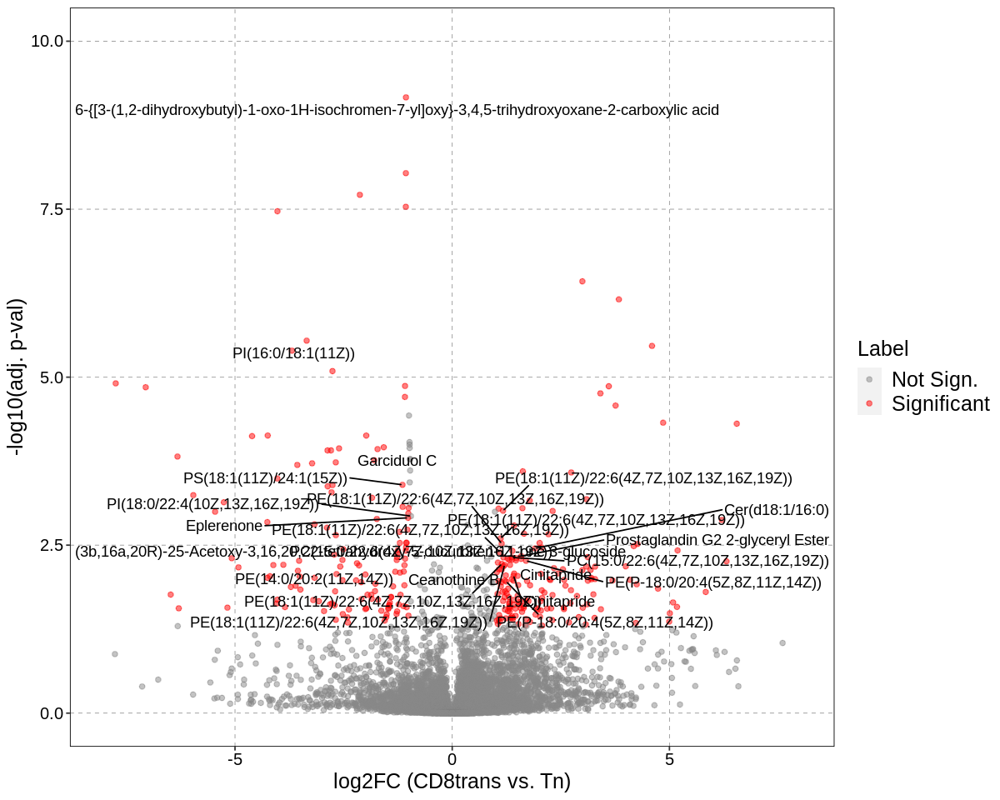

In [112]:
volcano_plot(   res_df = res_df,
                padj_colname = padj_colname,
                log2FC_colname = log2FC_colname,
                p_cut_off = 0.05,
                log2FC_cut_off = 1,
                xlab = glue("log2FC ({contrast})"),
                ylab = '-log10(adj. p-val)',
                xlim = c(-8,8),
                ylim = c(0,10),
                highlight_text = TRUE,
                fig_width = 10,
                fig_height = 8,
                text_size = 12,
                legend_size = 15,
                axis_title_size = 15,
                output_dir = out_dir,
                pdf_prefix = glue('{contrast}_with_highlight{topN}'),
                show_plot = TRUE)

-------

-------

-------

# Volcano plot
## log2FC CD8stem vs. Tn

In [113]:
colnames(res_df)[grep("Tpadj",colnames(res_df))]

[1] "Tpadj_CD8TD.CD8stem"    "Tpadj_CD8trans.CD8stem" "Tpadj_Tn.CD8stem"      
[4] "Tpadj_CD8trans.CD8TD"   "Tpadj_Tn.CD8TD"         "Tpadj_Tn.CD8trans"

In [114]:
colnames(res_df)[grep("log2FC",colnames(res_df))]

[1] "log2FC_CD8stemvsTn"       "log2FC_CD8transvsTn"     
[3] "log2FC_CD8TDvsTn"         "log2FC_CD8transvsCD8stem"
[5] "log2FC_CD8TDvsCD8stem"    "log2FC_CD8TDvsCD8trans"

In [115]:
padj_colname = 'Tpadj_Tn.CD8stem'
log2FC_colname = 'log2FC_CD8stemvsTn'
contrast = "CD8stem vs. Tn"

### With highlight

### Select parameters for highlight

In [116]:
if(want2annotate_feature_name) {
    annot_df = read.csv(annot_file_name, sep = '\t') #somehow only dplyr read.csv works 
    res_df = select_topN2present(res_df, annot_df, topN)
}

Warning message:
“`arrange_()` was deprecated in dplyr 0.7.0.
ℹ Please use `arrange()` instead.
ℹ See vignette('programming') for more help”


In [117]:
want2annotate_feature_name = TRUE
topN = 200

In [118]:
unique(res_df$highlight)

[1] ""                                                                                                
 [2] "6-{[3-(1,2-dihydroxybutyl)-1-oxo-1H-isochromen-7-yl]oxy}-3,4,5-trihydroxyoxane-2-carboxylic acid"
 [3] "PI(16:0/18:1(11Z))"                                                                              
 [4] "(3b,16a,20R)-25-Acetoxy-3,16,20,22-tetrahydroxy-5-cucurbiten-11-one 3-glucoside"                 
 [5] "Garciduol C"                                                                                     
 [6] "PS(18:1(11Z)/24:1(15Z))"                                                                         
 [7] "Eplerenone"                                                                                      
 [8] "PI(18:0/22:4(10Z,13Z,16Z,19Z))"                                                                  
 [9] "Cinitapride"                                                                                     
[10] "Prostaglandin G2 2-glyceryl Ester"                                                               
[11] "PE(18:1(11Z)/22:6(4Z,7Z,10Z,13Z,16Z,19Z))"                                                       
[12] "Thymidine 5'-triphosphate"                                                                       
[13] "1,2-Disinapoylgentiobiose"

Warning message in min(x, na.rm = na.rm):
“no non-missing arguments to min; returning Inf”
Warning message in max(x, na.rm = na.rm):
“no non-missing arguments to max; returning -Inf”


[1] "range of log10padj: 0\nrange of log2FC: Inf"                
[2] "range of log10padj: 13.0282473235653\nrange of log2FC: -Inf"
[1] "With highlighted text"


Warning message:
“Removed 26 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 26 rows containing missing values (`geom_point()`).”


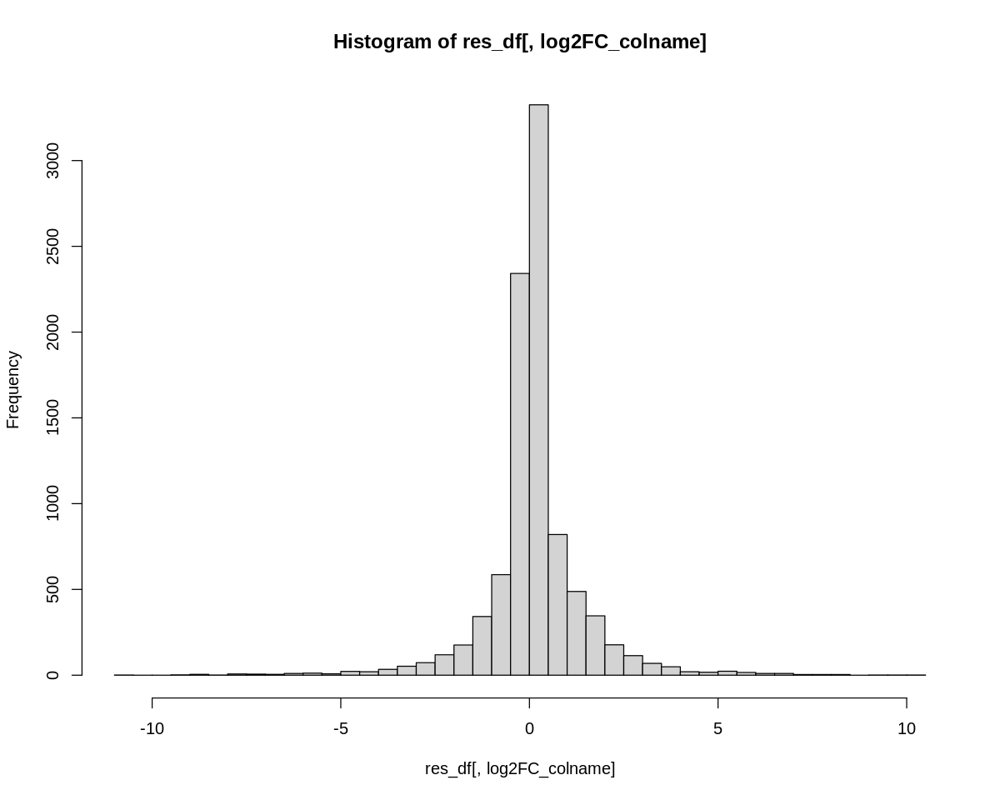

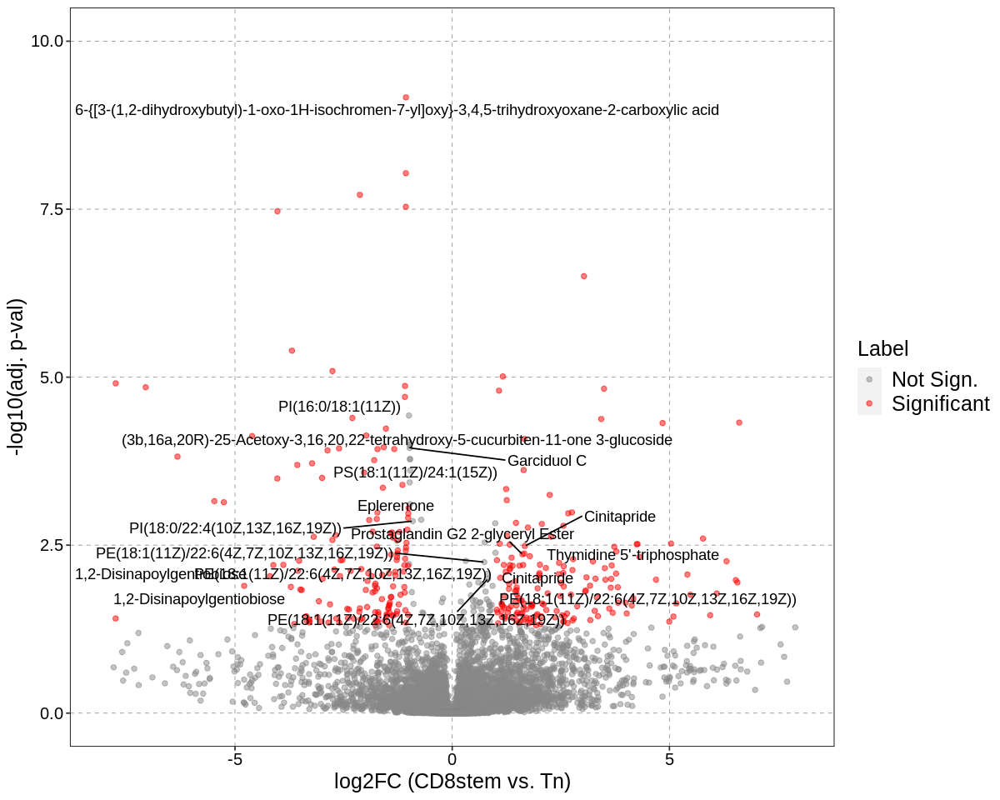

In [119]:
volcano_plot(   res_df = res_df,
                padj_colname = padj_colname,
                log2FC_colname = log2FC_colname,
                p_cut_off = 0.05,
                log2FC_cut_off = 1,
                xlab = glue("log2FC ({contrast})"),
                ylab = '-log10(adj. p-val)',
                xlim = c(-8,8),
                ylim = c(0,10),
                highlight_text = TRUE,
                fig_width = 10,
                fig_height = 8,
                text_size = 12,
                legend_size = 15,
                axis_title_size = 15,
                output_dir = out_dir,
                pdf_prefix = glue('{contrast}_with_highlight{topN}'),
                show_plot = TRUE)

------

------

------

# Volcano plot
## log2FC CD8trans vs. CD8stem

In [120]:
colnames(res_df)[grep("Tpadj",colnames(res_df))]

[1] "Tpadj_CD8TD.CD8stem"    "Tpadj_CD8trans.CD8stem" "Tpadj_Tn.CD8stem"      
[4] "Tpadj_CD8trans.CD8TD"   "Tpadj_Tn.CD8TD"         "Tpadj_Tn.CD8trans"

In [121]:
colnames(res_df)[grep("log2FC",colnames(res_df))]

[1] "log2FC_CD8stemvsTn"       "log2FC_CD8transvsTn"     
[3] "log2FC_CD8TDvsTn"         "log2FC_CD8transvsCD8stem"
[5] "log2FC_CD8TDvsCD8stem"    "log2FC_CD8TDvsCD8trans"

In [122]:
padj_colname = 'Tpadj_CD8trans.CD8stem'
log2FC_colname = 'log2FC_CD8transvsCD8stem'
contrast = "CD8trans vs. CD8stem"

### With highlight

### Select parameters for highlight

In [123]:
if(want2annotate_feature_name) {
    annot_df = read.csv(annot_file_name, sep = '\t') #somehow only dplyr read.csv works 
    res_df = select_topN2present(res_df, annot_df, topN)
}

Warning message:
“`arrange_()` was deprecated in dplyr 0.7.0.
ℹ Please use `arrange()` instead.
ℹ See vignette('programming') for more help”


In [124]:
want2annotate_feature_name = TRUE
topN = 200

In [125]:
unique(res_df$highlight)

[1] ""                                                                                           
 [2] "(3b,16a,20R)-25-Acetoxy-3,16,20,22-tetrahydroxy-5-cucurbiten-11-one 3-glucoside"            
 [3] "PI(16:0/18:1(11Z))"                                                                         
 [4] "PE(P-18:0/20:4(5Z,8Z,11Z,14Z))"                                                             
 [5] "PE(14:0/20:2(11Z,14Z))"                                                                     
 [6] "PE(22:4(7Z,10Z,13Z,16Z)/P-18:0)"                                                            
 [7] "PC(15:0/18:3(6Z,9Z,12Z))"                                                                   
 [8] "GlcCer(d18:1/16:0)"                                                                         
 [9] "PE(18:1(11Z)/22:6(4Z,7Z,10Z,13Z,16Z,19Z))"                                                  
[10] "PG(18:0/18:1(11Z))"                                                                         
[11] "PI(16:0/22:4(10Z,13Z,16Z,19Z))"                                                             
[12] "(1R,3R,4R,5S,6S,8x)-1-Acetoxy-8-angeloyloxy-3,4-epoxy-5-hydroxy-7(14),10-bisaboladien-2-one"
[13] "PC(15:0/20:5(5Z,8Z,11Z,14Z,17Z))"                                                           
[14] "Cer(d18:1/16:0)"                                                                            
[15] "PS(15:0/22:0)"                                                                              
[16] "Valsartan"                                                                                  
[17] "PC(15:0/16:1(9Z))"

Warning message in min(x, na.rm = na.rm):
“no non-missing arguments to min; returning Inf”
Warning message in max(x, na.rm = na.rm):
“no non-missing arguments to max; returning -Inf”


[1] "range of log10padj: 0\nrange of log2FC: Inf"                
[2] "range of log10padj: 13.0282473235653\nrange of log2FC: -Inf"
[1] "With highlighted text"


Warning message:
“Removed 1 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 1 rows containing missing values (`geom_point()`).”


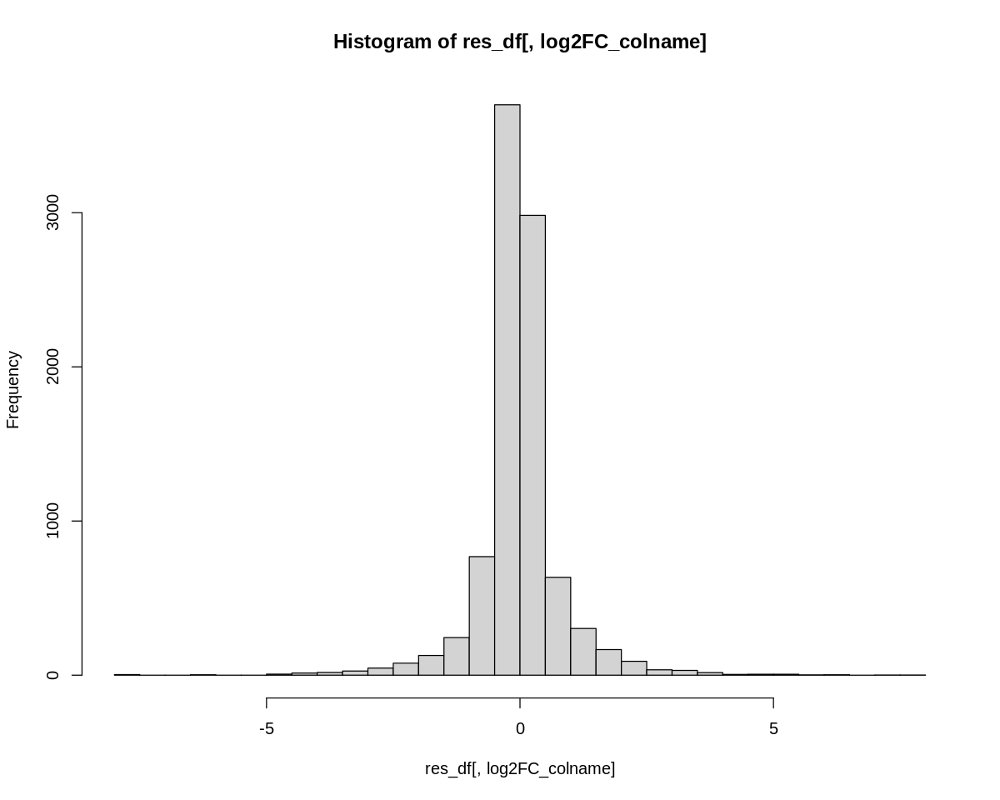

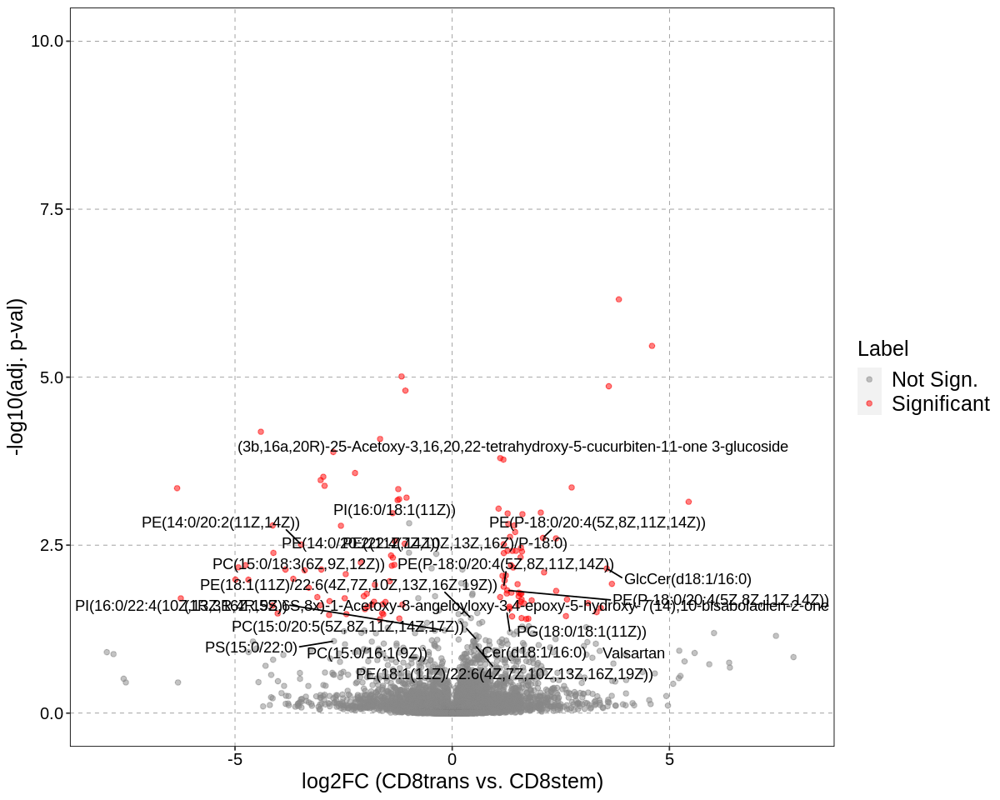

In [126]:
volcano_plot(   res_df = res_df,
                padj_colname = padj_colname,
                log2FC_colname = log2FC_colname,
                p_cut_off = 0.05,
                log2FC_cut_off = 1,
                xlab = glue("log2FC ({contrast})"),
                ylab = '-log10(adj. p-val)',
                xlim = c(-8,8),
                ylim = c(0,10),
                highlight_text = TRUE,
                fig_width = 10,
                fig_height = 8,
                text_size = 12,
                legend_size = 15,
                axis_title_size = 15,
                output_dir = out_dir,
                pdf_prefix = glue('{contrast}_with_highlight{topN}'),
                show_plot = TRUE)